# ** 5 Python Financial Visualization**
파이썬을 활용한 금융분석

### **review Data Datum**
1. Datum(숫자, "문자"), Data([list], {dict}, (tuple,))
1. 문자.replace(), .split(), .find()
1. (기본/외부/사용자) 모듈, 함수, 메소드
1. []의 문자에서 활용( [index], [:slicing]), 함수를 활용{for : 반복, if :판단, enumerate() :순번 integer 출력}
1. 재무제표 Web Crawling ==> type 변경 ==> 시각화
1. ndarray, Series, Dataframe

### **review Series**
1. pd.Series( [ data ] , index = [ index ])
1. series 사칙연산
1. series [ Boolean 판단문 ]
1. series.index = [ list ]
1. series.isnull()
1. series.drop()

### **review DataFrame**
1. pd.DataFrame( { columns :  [ data ] , columns :  [ data ] } )
1. df.column이름
1. df.rename( columns = { 기존 column , 새로운 column } )
1. df.insert( 컬럼순서,  컬럼명 ,  data )
1. df [ index Slicing ]
1. df.iloc[ index slicing,  column slicing ]
1. df.reset_index()        :  index  -> column
1. df.set_index( '컬럼명' ) :  column -> index
1. df.sort_index()
1. df.sort_value()
1. df[ boolean 함수 ]
1. df[ boolean 함수 ].column이름
1. axis = 0 : index | axis = 1 : column
1. df.drop( 'index이름'  , axis = 0 )
1. df.drop( 'column이름' ,  axis = 1 )
1. df.index.tolist()
1. df.column.tolist()
1. pd.pivot_table(df,index = [], values = [], aggfunc = [], margins = True)

### **review DataFrame static**
1. .count()
1. .describe()
1. .min()     .max()
1. .idxmin()  .idxmax()
1. .quantile()   
1. .sum()
1. .mean()    .median()
1. .var() 분산 .std() 정규분산
1. .cumsum()  .cumprod()  누적 합    누적 곱
1. .cummin()  .cummax()   누적최소값, 누적최대값

### **review Series & DataFrame 결측치 제어하기**
1. df.dropna()
1. df.fillna(method='ffill',  limit=2)  # 결측치 대체
1. df.fillna(df.mean()['컬럼명'])   
1. Series.interpolate(method='time')    # 결측치 보간 (시계열적 특성을 부여가능)
1. Series.interpolate(method='values', limit=1, limit_direction='backward') # 'forward','backward','both'

### **review &nbsp; map, reduce, lambda, filter**
1. map & lambda : map(lambda x : str(x), [list])
1. map & lambda : list(map(lambda x : str(x), [list]))
1. map & lambda : <strike>[ map(lambda x : str(x), data) ]</strike>
1. Series & lambda : Series.apply(lambda x : str(x))
1. filter & lambda : list(filter(lambda x : x % 2 == 0,  data))
1. <strike>filter</strike> & DataFrame : DataFrame[ Series % 2 == 0 ]
1. reduce & lambda : reduce(lambda x, y: x+y, [1, 2, 3, 4, 5])      # 데이터 차원축소

### **review &nbsp; TimeSeries**
1. from datetime import datetime
1. pandas.date_range(end = '2017-07-01', periods=30, freq='BM')  
1. pandas.date_range('2017/8/8 09:09:09', periods=5, normalize=True)
1. [str(date.date()) &nbsp;&nbsp; for &nbsp;&nbsp; date &nbsp;&nbsp; in &nbsp;&nbsp; pd.date_range('2017/01/01', '2017/01/11')]

<br>
<br>
## **1 현재 주가데이터를 활용한 기술통계 **
1. https://github.com/pdevty/googlefinance-client-python
1. https://nbviewer.jupyter.org/gist/FinanceData/251a316216e5ded4dfbe2669e7d5f888
1. pandas_datareader 는 오류로 잘 안됨

<br>
### **01 주가 데이터 가져오기** 
날짜와 시간관리 데이터 상호교환

In [1]:
# 시간이 붙은 DateTimeIndex 를 날짜만 남기고 삭제하기
# import pandas as pd
# df          = df.reset_index()
# df['index'] = df['index'].apply(lambda x : x.date())  # apply는 index 에 바로 적용이 안되어서 컬럼으로 빼고 적용 --> str
# df          = df.set_index('index')                   # 컬럼을 다시 index로 삽입
# df.index    = pd.to_datetime(df_idx.index)            # index 를 DataTimeIndex 포맷으로 변경
# df.head()

In [3]:
from googlefinance.get import get_data
df = get_data(['KRX:005930','KRX:000020'], period='3Y')
df.head(3)

,code,open,high,low,close,volume
date,,,,,,
2015-04-13,KRX:005930,1479000.0,1491000.0,1468000.0,1479000.0,203599
2015-04-14,KRX:005930,1485000.0,1485000.0,1465000.0,1474000.0,188257
2015-04-15,KRX:005930,1460000.0,1470000.0,1427000.0,1446000.0,269985


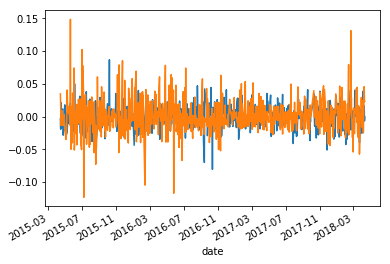

In [4]:
%matplotlib inline
df_one      = df[df.code == 'KRX:005930'].close
df_one.name = 'KRX:005930'
df_two      = df[df.code == 'KRX:000020'].close
df_two.name = 'KRX:000020'

df_one.pct_change().plot(kind='line')
df_two.pct_change().plot(kind='line')

In [5]:
import pandas as pd
df_temp = pd.concat([df_one, df_two], axis=1)
# df_temp.head()
# df_temp.cov()  # 공분산
df_temp.corr()  # 상관계수

,KRX:005930,KRX:000020
KRX:005930,1.000000,0.439469
KRX:000020,0.439469,1.000000


#### **Quiz**
    '삼성전자'와 '하이닉스', '네이버' 'KAKAO' 의 '3년' 주가 데이터를 수집한 뒤
    1. '종가 변화량'을 Line 차트로 시각화 하고
    2. '종가'의 상관계수를 비교하여 표로 출력하시오

<br>
### **02  DateTimeIndex _Series_ Index Slicing**
.ix[] : index 가 숫자일떄, 숫자를 기준으로 추출 (DateTimeIndex 에서 유용하다)

In [6]:
from googlefinance.get import get_data
#from pandas_datareader import get_data_google
df = get_data('NASDAQ:TSLA', period='2Y')
df.head(3)

,code,open,high,low,close,volume
date,,,,,,
2016-04-13,NASDAQ:TSLA,249.50,251.800,243.6300,247.82,5750757
2016-04-14,NASDAQ:TSLA,248.51,255.500,247.3300,254.53,4917930
2016-04-15,NASDAQ:TSLA,253.00,256.839,251.0501,251.86,4119980


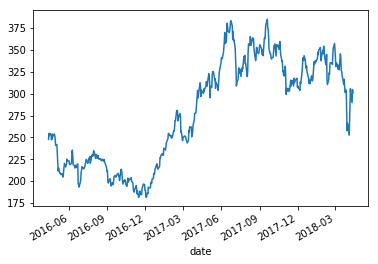

In [7]:
df.close.plot(kind='line')

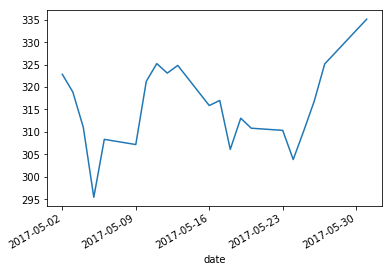

In [8]:
# [ 특정 기간만 출력 ]
df.close.loc['2017-05'].plot()

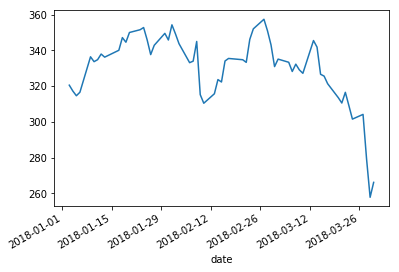

In [9]:
# [ 특정기간 : slicing ]
df.close.loc['2018-01':'2018-03'].plot()

<br>
### **03 TimeSeries Series  Slicing**
출처 : https://datascienceschool.net/view-notebook/8959673a97214e8fafdb159f254185e9/
1. **Series.resample()** 내부에 사용가능한 freq 옵션들
    1. **B :** 주말이 아닌 평일
    1. **W :** 주(일요일)
    1. **W-MON :** 주(월요일)
    1. **M :** 각 달(month)의 마지막 날
    1. **MS :** 각 달의 첫날
    1. **BM :** 주말이 아닌 평일 중에서 각 달의 마지막 날
    1. **BMS :** 주말이 아닌 평일 중에서 각 달의 첫날
    1. **WOM-2THU :** 각 달의 두번째 목요일
    1. **Q-JAN :** 각 분기의 첫달의 마지막 날
    1. **Q-DEC :** 각 분기의 마지막 달의 마지막 날
    
1. **Series.rolling(30).mean()**

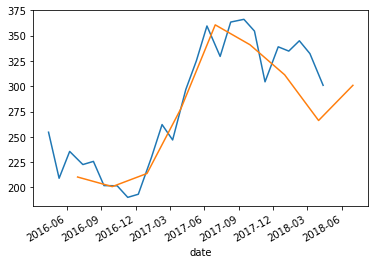

In [10]:
# df['Close'].plot()     # 매주 월요일
# df['Close'].resample('W-MON').ffill().plot()     # 매주 월요일
df['close'].resample('WOM-2THU').ffill().plot()  # 매달 2번쨰 목요일 기준
df['close'].resample('Q-DEC').ffill().plot()     # 분기별 마지막일 기준

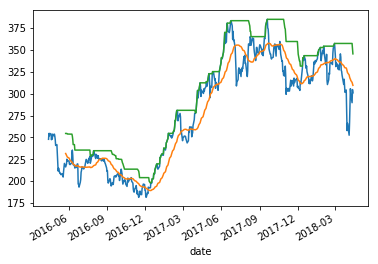

In [11]:
# 30일 이동평균선 출력하기
df.close.plot()
df.close.rolling(30).mean().plot()
df.close.rolling(30).max().plot()

#### **Quiz**
    2017-1-1 부터  2017-3-1 기간 중 매주 수요일 날짜만 출력하라

<br>
### **04 TimeSeries DataFrame Slicing**
1. Series.ix['날짜범위'] 
1. DataFrame.loc['시작날짜':'종료날짜', :] : 주소 이름을 활용하여 인덱싱
1. DataFrame.iloc[1:10, : ] # 주소값으로 인덱싱

<br>
<br>
## **2 Matplotlib 시각화**
1. https://matplotlib.org/tutorials/introductory/usage.html#sphx-glr-tutorials-introductory-usage-py
1. https://www.labri.fr/perso/nrougier/teaching/matplotlib/
1. & pip install **matplotlib**
1. https://matplotlib.org/api/markers_api.html (마커) 
    - ^ (삼각형), O (원), s(세모), v(역삼각형), < , > , + , . , * , x
1. https://matplotlib.org/api/colors_api.html (컬러)
    - b: blue, g: green, r: red, c: cyan, m: magenta, y: yellow, k: black, w: white

<img src="https://image.slidesharecdn.com/python08-150723163743-lva1-app6892/95/python-46-638.jpg" align='left' width='450'>

<br>
### **01 plt() 기본설정**
마커와 컬러의 설정

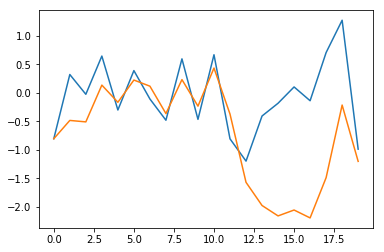

In [12]:
%matplotlib inline
# .plot() 대신에 plt() 함수를 사용
# Canvas를 정의하고 속성값을 입력한다
import numpy as np
import matplotlib.pyplot as plt

# 20개의 난수를 추출 (0 ~ 1 정규분포 난수)
np.random.seed(1000)
data = np.random.standard_normal(20)  
plt.plot(data)           
plt.plot(data.cumsum())  # cumsum() : 누적합

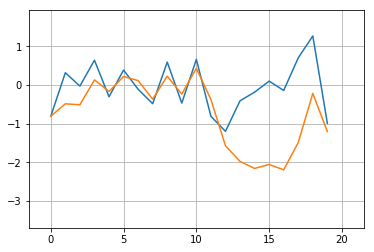

In [13]:
# plt.xlim(), .ylim() : Canvas의 범위를 지정한다
# 가독성 향상을 위해 상/하, 좌/우, -1.5/+1.5 

plt.plot(data)  
plt.plot(data.cumsum())
plt.xlim(-1.5, 21.5)
plt.ylim(np.min(data.cumsum()) - 1.5, 
         np.max(data.cumsum()) + 1.5)
plt.grid(True)

Text(0.5,1,'A Simple Plot')

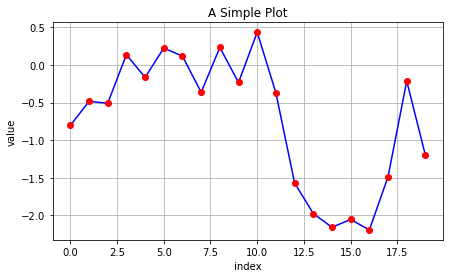

In [14]:
# Full setting Ploting.. (figsize = (너비, 높이))

plt.figure(figsize=(7, 4))
plt.plot(data.cumsum(), 'b', lw=1.5)  # 'b' : 파란색 실선, 'lw' : Line Width
plt.plot(data.cumsum(), 'ro')         # 해당 dot 마다 빨간 원 (red circle)
plt.grid(True)
plt.axis('tight')
plt.xlabel('index'); plt.ylabel('value'); plt.title('A Simple Plot')

<br>
### **02  다차원 plt**
numpy.Array 

In [15]:
# 2차원 배열을 생성
np.random.seed(2000)
data = np.random.standard_normal((20, 2)).cumsum(axis=0)
data.shape             # 2차원 데이터 생성

(20, 2)

Text(0.5,1,'A Simple Plot')

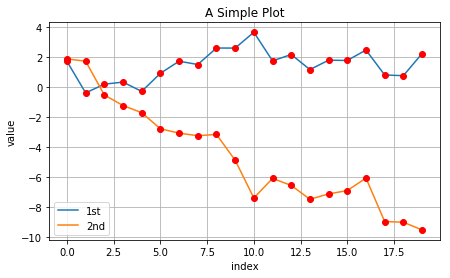

In [16]:
# 2차원 데이터 나눠서 정의하기
plt.figure(figsize=(7, 4))
plt.plot(data[:, 0], lw=1.5, label='1st')  
plt.plot(data[:, 1], lw=1.5, label='2nd')
plt.plot(data, 'ro')                        # red dot 을 index 별로 찍음
plt.grid(True)
plt.legend(loc=0)
plt.axis('tight')
plt.xlabel('index')
plt.ylabel('value')
plt.title('A Simple Plot')

<br>
### **03  차이가 많이나는 2차원 plt**
객체를 사용하여 여러개의 그림을 구분하여 제어한다

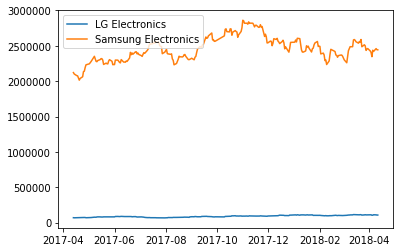

In [17]:
# googlefinance.get로 주식가격 분석하기
from googlefinance.get import get_data

data = get_data(["KRX:066570","KRX:005930"], period='1Y')
lg = data[data.code=="KRX:066570"].close
ss = data[data.code=="KRX:005930"].close
plt.plot(lg.index, lg, label='LG Electronics')
plt.plot(ss.index, ss, label='Samsung Electronics')
plt.legend(loc='upper left')
plt.show()

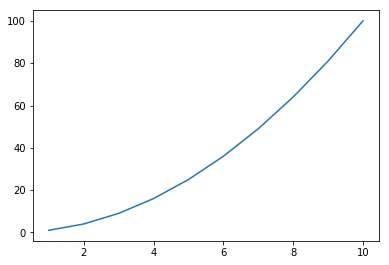

In [18]:
# 객체를 사용하여 그림그리기
%matplotlib inline

x = np.linspace(1,10,10)
y = x ** 2

fig = plt.figure()
axes = fig.add_axes( [.1, .1, .8, .8])
axes.plot(x,y)

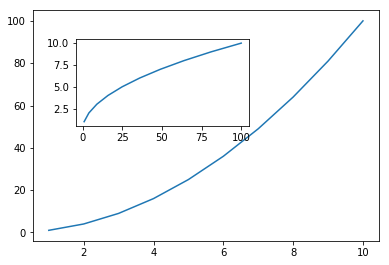

In [19]:
# 객체를 사용하여 여러개의 그림을 구분하여 제어한다
fig = plt.figure()
ax1 = fig.add_axes( [.1, .1, .8, .8])
ax2 = fig.add_axes( [.2, .5, .4, .3])
ax2.plot(y,x)
ax1.plot(x,y)


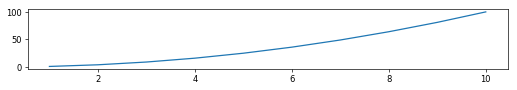

In [20]:
fig = plt.figure(figsize=(8,1), dpi=60)
ax = fig.add_axes([0,0, 1,1])
ax.plot(x,y)
fig.savefig('my_Pic.jpg', dpi=200)

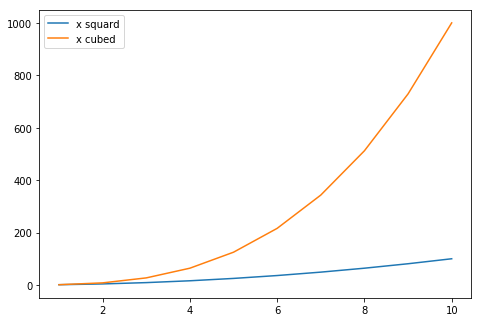

In [21]:
fig = plt.figure()
ax= fig.add_axes([0,0, 1,1])
ax.plot(x, x**2, label='x squard')
ax.plot(x, x**3, label='x cubed')
ax.legend()

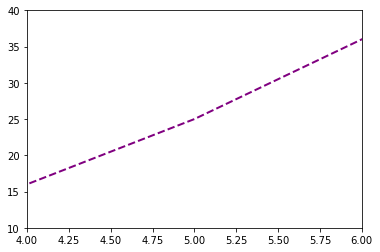

In [22]:
fig = plt.figure()
ax = fig.add_subplot(111)
# ax= fig.add_axes([0,0, 1,1])
ax.plot(x, x**2, color= 'purple', lw=2, ls = '--')
ax.set_xlim([4,6])
ax.set_ylim([10,40])
plt.show()

(736413.85, 736813.15, 64150.0, 115850.0)

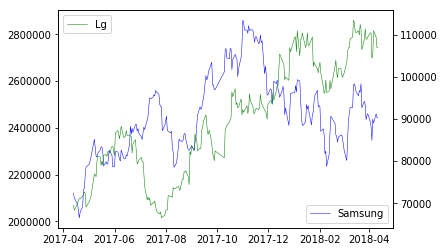

In [23]:
# Canvas의 좌/우 축을 다르게 적용
fig, ax1 = plt.subplots()
plt.plot(ss, 'b', lw=.5, label='Samsung')
plt.legend(loc=4); plt.axis('tight')

# 두번쨰 자료를 오른쪽축에 대응
ax2 = ax1.twinx()   
plt.plot(lg, 'g', lw=.5, label='Lg')
plt.legend(loc=0); plt.axis('tight')

Text(0,0.5,'value')

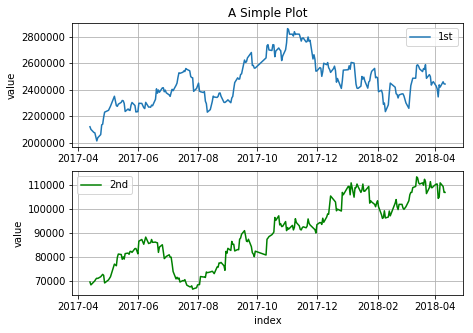

In [24]:
# Canvas 전체의 크기를 정의한다
plt.figure(figsize=(7, 5)) 

plt.subplot(211)           # row, col // fig 위치값 (2X1 중 1번)
plt.plot(ss, lw=1.5, label='1st')
plt.grid(True); plt.legend(loc=0); plt.axis('tight')
plt.title('A Simple Plot'); plt.ylabel('value')

plt.subplot(212)           # row, col // fig 위치값 (2X1 중 1번)
plt.plot(lg, 'g', lw=1.5, label='2nd')
plt.grid(True); plt.legend(loc=0); plt.axis('tight')
plt.xlabel('index'); plt.ylabel('value')

Text(0.5,1,'2nd Data Set')

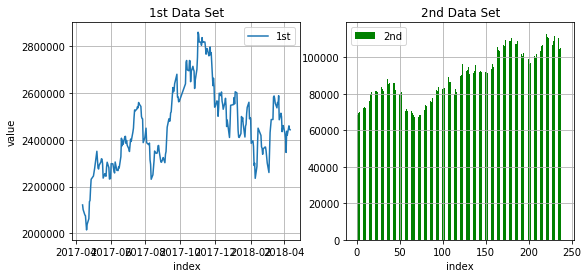

In [25]:
# Canvas 전체의 크기를 정의한다
plt.figure(figsize=(9, 4))

plt.subplot(121)               # row, col // fig 위치값 (1X2 중 1번)
plt.plot(ss, lw=1.5, label='1st')
plt.grid(True); plt.legend(loc=0); plt.axis('tight')
plt.xlabel('index'); plt.ylabel('value'); plt.title('1st Data Set')

plt.subplot(122)               # row, col // fig 위치값 (1X2 중 2번)
plt.bar(np.arange(len(lg)), lg, width=0.5, color='g', label='2nd')
plt.grid(True); plt.legend(loc=0); plt.axis('tight')
plt.xlabel('index'); plt.title('2nd Data Set')

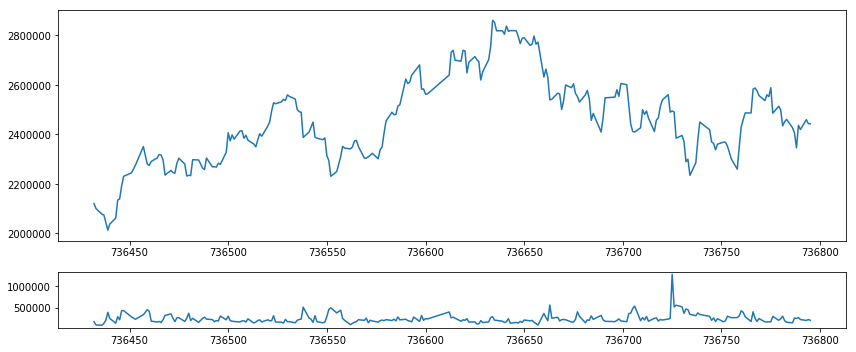

In [26]:
# .subplot2grid()로 1개의 캔바스에 2개를, 크기에 맞춰서 그리기
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
ss_history = data[data.code=="KRX:005930"]
ss_history.index = ss_history.index.map(mdates.date2num)   # Date 컬럼을 matplot 포맷으로 변환

fig         = plt.figure(figsize=(12, 5)) # 이미지 객체를 1개생성, 대신 크기값 지정
top_axes    = plt.subplot2grid((4,4), (0,0), rowspan=3, colspan=4)
bottom_axes = plt.subplot2grid((4,4), (3,0), rowspan=1, colspan=4)
bottom_axes.get_yaxis().get_major_formatter().set_scientific(False)

top_axes.plot(ss_history.index, ss_history.close, label='Adjusted Close')
bottom_axes.plot(ss_history.index, ss_history.volume)

plt.tight_layout() # 자동으로 최대크기의 그림으로 출력
plt.show()

<br>
### **04-1 Candle Stick Charts**
1. 출처1 : https://stackoverflow.com/questions/42437349/candlestick-plot-from-a-pandas-dataframe
1. 출처2 : https://matplotlib.org/api/finance_api.html
1. 출처3 : https://github.com/matplotlib/mpl_finance
1. mpl_finance 는 matplotlib 2.0 에서 별도로 분리되었다
1. ! pip install --no-cache-dir https://github.com/matplotlib/mpl_finance/archive/master.zip --upgrade

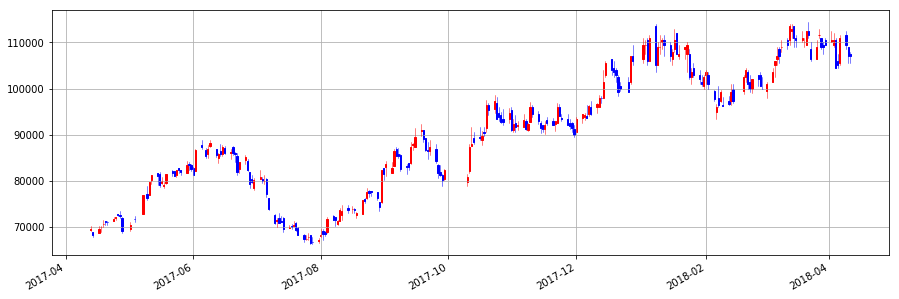

In [27]:
import matplotlib.dates as mdates
lg_history = data[data.code=="KRX:066570"].iloc[:,1:-1].reset_index()
lg_history['date'] = lg_history['date'].map(mdates.date2num)          # Date 컬럼을 matplot 포맷으로 변환

# 캔들차트를 시각화
import mpl_finance as mpf
fig, ax = plt.subplots(figsize=(15, 5))
mpf.candlestick_ohlc(ax, 
                     lg_history.values , 
                     width=0.6, colorup='r', colordown='b')    # UP:red, Down:blue
plt.grid(True)
ax.xaxis_date(); ax.autoscale_view(); fig.autofmt_xdate()      # x 축에 날짜를 추가한다

<br>
### **04-2 Candle Stick Charts 2**
날짜를 수정하여 부분적인 Chart 출력

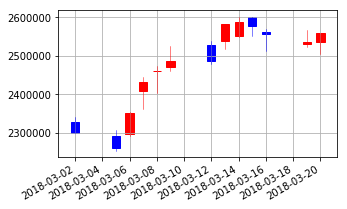

In [28]:
ss_history = data[data.code=="KRX:005930"].loc['2018-03-01':'2018-03-20', :]
ss_history = ss_history.iloc[:, 1:-1].reset_index()
ss_history['date'] = ss_history['date'].map(mdates.date2num)          # Date 컬럼을 matplot 포맷으로 변환

# 캔들차트를 시각화
fig, ax = plt.subplots(figsize=(5, 3))
mpf.candlestick_ohlc(ax, 
                     ss_history.values , 
                     width=0.6, colorup='r', colordown='b')    # UP:red, Down:blue
plt.grid(True)
ax.xaxis_date(); ax.autoscale_view(); fig.autofmt_xdate()      # x 축에 날짜를 추가한다

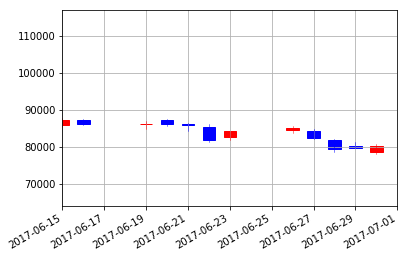

In [29]:
# .set_xlim : 을 활용하여 데이터 영역 제한하기
# y축도 별도로 영역제한을 해야하는 불편함이 있다
import matplotlib.dates as mdates
lg_history = data[data.code=="KRX:066570"].iloc[:,1:-1].reset_index()
lg_history['date'] = lg_history['date'].map(mdates.date2num)       # Date 컬럼을 matplot 포맷으로 변환

# 캔들차트를 시각화
fig, ax = plt.subplots(figsize=(6, 4))
mpf.candlestick_ohlc(ax, 
                     lg_history.values , 
                     width=0.6, colorup='r', colordown='b')         # UP:red, Down:blue
plt.grid(True)
ax.set_xlim(pd.Timestamp('2017-06-15'), pd.Timestamp('2017-07-01')) # .set_xlim()
ax.xaxis_date(); ax.autoscale_view(); fig.autofmt_xdate()           # x 축에 날짜를 추가한다

<br>
### **04-3 Candle Stick Charts 3**
캔들차트와 거래량 차트 함께 표시하기

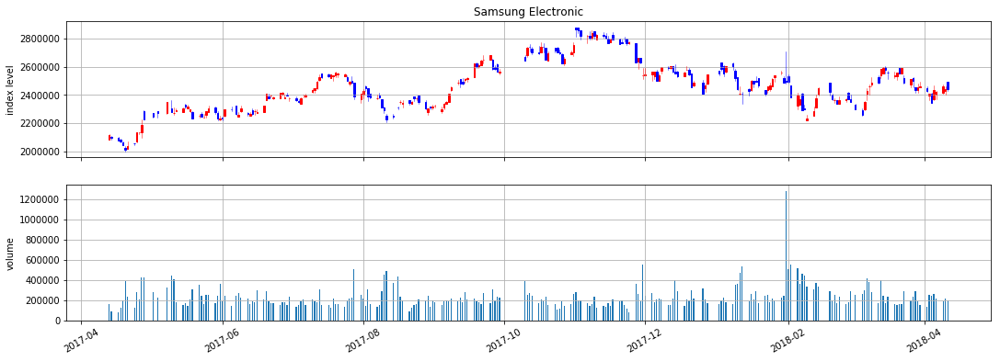

In [30]:
# 캔들차트 데이터와, 거래량 데이터 비교하기
ss_history = data[data.code=="KRX:005930"].loc['2017-03-01':'2018-04-20', :]
ss_history_candle = ss_history.iloc[:, 1:-1].reset_index()
ss_history_volume = ss_history.iloc[:, -1].reset_index()
ss_history_candle['date'] = ss_history_candle['date'].map(mdates.date2num)   # Date 컬럼을 matplot 포맷으로 변환

fig, (ax1, ax2) = plt.subplots(2, sharex=True, figsize=(18, 6))
mpf.candlestick_ohlc(ax1, ss_history_candle.values,
                     width=0.6, 
                     colorup='r', colordown='b')
ax1.set_title('Samsung Electronic'); ax1.set_ylabel('index level'); ax1.grid(True); ax1.xaxis_date()

plt.bar(ss_history_candle.date, ss_history_volume.volume, width=0.5) # candel과 mdate 포맷을 일치시켜야 작동한다
ax2.set_ylabel('volume');   ax2.grid(True)
ax2.autoscale_view()
plt.setp(plt.gca().get_xticklabels(), rotation=30);

<br>
### **04 matplotlib 종합**
matplotlib 

In [31]:
%matplotlib inline

# import Data
import requests, datetime
import pandas as pd
import matplotlib.pyplot as plt
from googlefinance.get import get_data
code = 'KRX:005930'
stock_history = get_data(code, period='2Y')
stock_history['MA_5']  = stock_history['close'].rolling(window=5, center=False).mean()
stock_history['MA_20'] = stock_history['close'].rolling(window=20, center=False).mean()
stock_history['diff']  = stock_history['MA_5'] - stock_history['MA_20']

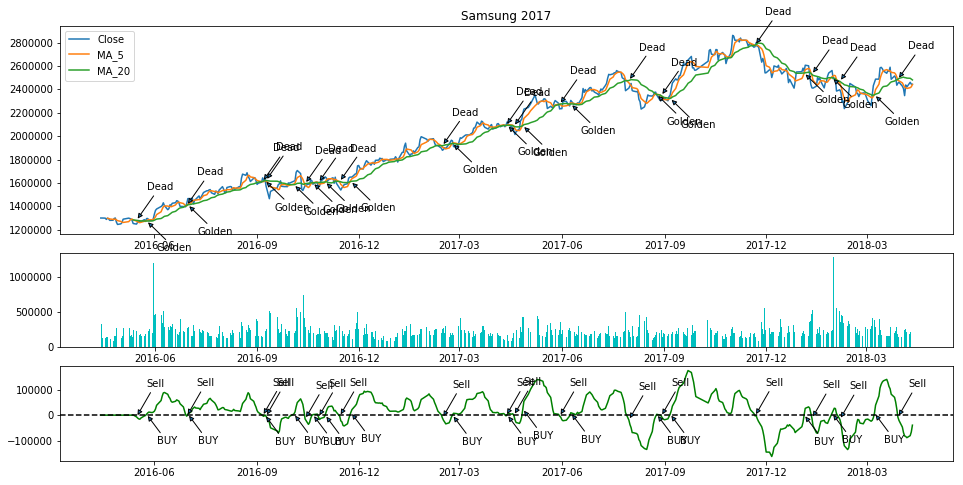

In [32]:
fig = plt.gcf()
fig.set_size_inches(16,8)

price_chart = plt.subplot2grid((4,1),(0,0),rowspan=2)
price_chart.plot(stock_history.index, stock_history['close'], label = 'Close')
price_chart.plot(stock_history.index, stock_history['MA_5'], label = 'MA_5')
price_chart.plot(stock_history.index, stock_history['MA_20'], label = 'MA_20')

plt.title("Samsung 2017")
plt.legend(loc='best')

# 거래량 chart 를 구현
vol_chart = plt.subplot2grid((4,1),(2,0), rowspan = 1)
vol_chart.bar(stock_history.index, stock_history['volume'], color = 'c')

signal_chart = plt.subplot2grid((4,1), (3,0), rowspan=1)
signal_chart.plot(stock_history.index, stock_history['diff'].fillna(0), color = 'g')
plt.axhline(y=0, linestyle = '--', color = 'k')

prev_key = prev_val = 0
for key, val in stock_history['diff'][1:].iteritems():
    if val == 0:
        continue
        
    # Golden Cross 를 판단하는 조건문
    elif val * prev_val < 0 and val > prev_val: #print('GOLD', key, val)
        # 가격변화 chart 위에 표시
        price_chart.annotate('Golden', xy = (key, stock_history['MA_20'][key]), xytext=(10,-30), 
                             textcoords='offset points', arrowprops=dict(arrowstyle='-|>'))        
        # signal chart 위에 표시
        signal_chart.annotate('BUY', xy = (key, stock_history['diff'][key]), xytext=(10,-30),
                              textcoords='offset points', arrowprops=dict(arrowstyle='-|>'))        
    
    # Death Cross 를 판단하는 조건문
    elif val * prev_val < 0 and val < prev_val: #print('DEAD', key, val)
        # 가격변화 chart 위에 표시
        price_chart.annotate('Dead', xy = (key, stock_history['MA_20'][key]), xytext=(10,30),
                             textcoords='offset points', arrowprops=dict(arrowstyle='-|>'))
        # signal chart 위에 표시
        signal_chart.annotate('Sell', xy = (key, stock_history['diff'][key]), xytext=(10,30),
                             textcoords='offset points', arrowprops=dict(arrowstyle='-|>'))
    prev_key, prev_val = key, val

<br>
### **05 Bar Chart**
캔들차트와 거래량 차트 함께 표시하기

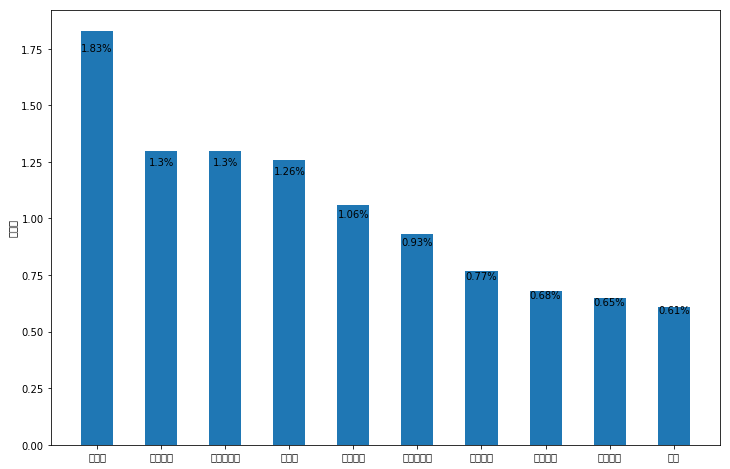

In [33]:
from matplotlib import font_manager, rc
from matplotlib import style

industry = ['통신업', '의료정밀', '운수창고업', '의약품', '음식료품', '전기가스업', '서비스업', '전기전자', '종이목재', '증권']
fluctuations = [1.83, 1.30, 1.30, 1.26, 1.06, 0.93, 0.77, 0.68, 0.65, 0.61]

fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111)
pos = np.arange(len(industry))
rects = plt.bar(pos, fluctuations, align='center', width=0.5)
plt.xticks(pos, industry)

for i, rect in enumerate(rects):
    ax.text(rect.get_x() + rect.get_width() / 2.0, 0.95 * rect.get_height(), str(fluctuations[i]) + '%', ha='center')
plt.rcParams['axes.unicode_minus'] = False
plt.ylabel('등락률')
plt.show()

<br>
###  **06. Pie Chart**
파이차트 그리기

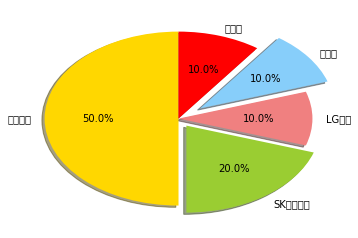

In [34]:
plt.pie([50, 20, 10, 10, 10],
        explode = (0.0, 0.1, 0.0, 0.2, 0.), # 확대값 : 중심축 이탈 거리값 지정
        labels  = ['삼성전자', 'SK하이닉스', 'LG전자', '네이버', '카카오'],
        colors  = ['gold', 'yellowgreen', 'lightcoral', 'lightskyblue', 'red'], 
        autopct = '%1.1f%%', 
        shadow  = True, startangle = 90)
plt.show()

<br>
<br>
## **3 Plotly 를 활용한 시각화**
plotlywrapper's API 실습
1. pip install plotly   
1. pip install plotlywrapper
1. pip install plotly --upgrade 
1. 출처: http://hamait.tistory.com/800 [HAMA 블로그]
1. To learn more take a look at the https://github.com/jwkvam/plotlywrapper
1. https://medium.com/@peteryun/python-matplotlib-%EA%B8%B0%EB%B3%B8-6e23e5fd2f16
    1. API key : pjUDZ38kzM21hU0puZAk
    1. Streaming API tokens : jrffvs64ux

In [37]:
import pandas as pd
import numpy as np
from numpy import random

# 간단한 데이터로 plotly 구현
n         = 100
X         = random.randn(100, 3)                                           # -3 ~ +3 정규분포 난수 100개 생성
timeline  = pd.date_range('2018', periods=n, freq=pd.DateOffset(hours=1))  # 18-01-01 00:00 ~ 1시간 간격 100개 인덱스 생성
df = pd.DataFrame(X, timeline, columns=['alpha', 'beta', 'gamma'])
df.head(3)

,alpha,beta,gamma
2018-01-01 00:00:00,-0.523810,0.597464,-2.316823
2018-01-01 01:00:00,-0.041727,-0.352472,-2.336780
2018-01-01 02:00:00,0.867536,0.926779,-1.705922


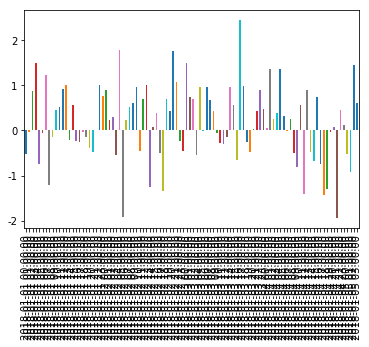

In [38]:
%matplotlib  inline
df['alpha'].plot('bar')

<br>
###  **01. plotlywrapper**
해당 모듈을 불러오면, DataFrame에 메소드로 그래프를 그릴 수 있다

In [39]:
# scatter 산점도 시각화
# import plotlywrapper as pw
# 모듈을 불러오기만 해도 DataFrame 객체의 메소드로 자동적 활용 가능하다

import plotlywrapper as pw
df.plotly.scatter()

In [40]:
# bar chart 로 시각화 
df.plotly.bar()

In [41]:
# 여러개의 plotly chart를 겹쳐서 회면에 출력
plot  = df.plotly.bar()               # bar chart 출력
plot += df.plotly.line(opacity=0.7)  # line chart 출력
plot.ylabel('deliciousness')
plot.xlabel('xlabel')

In [42]:
# 여러 그래프를 1개의 객체에 담은 뒤, 객체를 실행
plot = pw.fill_between(ylow  = X[:, 0], 
                       yhigh = X[:, 1])  # ylow 와 yhigh 사이를 칠한다
plot += pw.fill_zero(X[:, 2])             # 칠하는 공간없이 line만 출력
plot

<br>
###  **02. 3D plotlywrapper**
x, y, z 3차원 으로 좌표값을 부여하면 그림을 그릴 수 있다

In [43]:
# 3차원 시각화
def fxy(x, y):
    A = 1  # choose a maximum amplitude 
    return A *( np.cos( np.pi * x * y ) ) ** 2 * np.exp( -(x ** 2 + y ** 2 ) / 2. )
L = 4
x = y = np.arange(-L/2., L/2., 0.1)  # use a mesh spacing of 0.1
z = fxy(x, y[:, None])

# pw.surface 공간에 출력
pw.surface(x, y, z)

In [44]:
t = np.linspace(0, 4*np.pi)
x = np.sin(t)
y = np.cos(t)
x2 = np.sin(t - np.pi)
y2 = np.cos(t - np.pi)
pw.line3d(x, y, t, width=10) + pw.line3d(x2, y2, t, width=5)

<br>
###  **03. 주가차트 그리기 by plotly**
http://excelsior-cjh.tistory.com/108?category=975542
1. 캔들차트 그리기
1. line chart
1. 복합 chart

In [45]:
import plotly.offline as offline 
import plotly.graph_objs as go 

# jupyter notebook 에서 출력 
stock = get_data("KRX:005930", period='1Y')
offline.init_notebook_mode(connected=True) 
trace = go.Candlestick(x = stock.index, 
                       open = stock.open, 
                       high = stock.high, 
                       low = stock.low, 
                       close = stock.close) 

data = [trace]
layout = go.Layout(title='삼성전자 캔들차트') 
fig = go.Figure(data = data, layout = layout) 
offline.iplot(fig, filename = "candlestick")

In [46]:
# 필요한 모듈 import 하기 
import plotly.offline as offline 
import plotly.graph_objs as go 

# jupyter notebook 에서 출력 
item_name = "삼성전자"
offline.init_notebook_mode(connected=True) 
trace = go.Scatter( x = stock.index, 
                    y = stock.close, 
                    name = item_name) 
data = [trace] 
layout = dict(
            title = '{}의 종가(close) Time Series'.format(item_name), 
            xaxis = dict( 
                rangeselector = dict( 
                    buttons   = list([ 
                        dict( count    = 1, 
                              label    = '1m', 
                              step     = 'month', 
                              stepmode = 'backward'), 
                        dict( count    = 3, 
                              label    = '3m', 
                              step     = 'month', 
                              stepmode = 'backward'), 
                        dict( count    = 6, 
                              label    = '6m', 
                              step     = 'month', 
                              stepmode ='backward'), 
                        dict( count    = 12, 
                              label    = '12m', 
                              step     = 'month', 
                              stepmode = 'backward'), 
                        dict( step = 'all') ]) ),
                rangeslider = dict(), 
                type = 'date')) 
fig = go.Figure(data=data, layout=layout) 
offline.iplot(fig)

In [47]:
from plotly import tools
import plotly.offline as offline
import plotly.graph_objs as go 

def get_macd(df, short=12, long=26, t=9):
    df    = pd.DataFrame(df)              # MACD 관련 수식 
    ma_12 = df.close.ewm(span=12).mean()  # 단기이동평균(12) EMA(지수이동평균) 
    ma_26 = df.close.ewm(span=26).mean()  # 장기이동평균(26) EMA 
    macd  = ma_12 - ma_26                 # MACD  : 단기(12)와 장기(26)의 차이값으로 (MA의 수렴과 발산 원리를 이용) 
    macds = macd.ewm(span=9).mean()       # Signal : MACD의 9일 이동평균으로 MACD 값들을 완충 및 일반화
    macdo = macd - macds                  # Oscillator : MACD이 Signal보다 클때 '+',작을 때는 '-' 막대를 그린다
    df    = df.assign(macd=macd, macds=macds, macdo=macdo).dropna() 
    return df

df_stock = get_macd(stock) # 상위 5개 데이터 확인 
df_stock.head(2)

macd         = go.Scatter(x = df_stock.index, 
                          y = df_stock['macd'], 
                          name = "MACD") 
signal       = go.Scatter(x = df_stock.index, 
                          y = df_stock['macds'], 
                          name = "Signal") 
oscillator   = go.Bar(x = df_stock.index, 
                      y = df_stock['macdo'], 
                      name = "oscillator") 
trade_volume = go.Bar(x = df_stock.index, 
                      y = df_stock['volume'], 
                      name = "volume") 
data = [macd, signal, oscillator]
layout = go.Layout(title = '{} MACD 그래프'.format(item_name)) 
fig = tools.make_subplots(rows = 2, cols = 1, shared_xaxes = True) 
for trace in data: 
    fig.append_trace(trace, 1, 1) 

fig.append_trace(trade_volume, 2, 1)
offline.iplot(fig)

This is the format of your plot grid:
[ (1,1) x1,y1 ]
[ (2,1) x1,y2 ]



<br>
###  **04. python-nvD3 로 Html로 시각화 출력하기**
https://github.com/areski/python-nvd3  API 매뉴얼
1. ! pip install python-nvd3
1. django 코드에 HTML로 활용하기에 유용하다

In [48]:
from nvd3 import pieChart
type = 'pieChart'
chart = pieChart(name=type, color_category='category20c', height=450, width=450)
xdata = ["Orange", "Banana", "Pear", "Kiwi", "Apple", "Strawberry", "Pineapple"]
ydata = [3, 4, 0, 1, 5, 7, 3]
extra_serie = {"tooltip": {"y_start": "", "y_end": " cal"}}
chart.add_serie(y=ydata, x=xdata, extra=extra_serie)
chart.buildcontent()
print(chart.htmlcontent)

loaded nvd3 IPython extension
run nvd3.ipynb.initialize_javascript() to set up the notebook
help(nvd3.ipynb.initialize_javascript) for options

    <div id="piechart"><svg style="width:450px;height:450px;"></svg></div>


    <script>



    data_piechart=[{"values": [{"label": "Orange", "value": 3}, {"label": "Banana", "value": 4}, {"label": "Pear", "value": 0}, {"label": "Kiwi", "value": 1}, {"label": "Apple", "value": 5}, {"label": "Strawberry", "value": 7}, {"label": "Pineapple", "value": 3}], "key": "Serie 1"}];

    nv.addGraph(function() {
        var chart = nv.models.pieChart();
        chart.margin({top: 30, right: 60, bottom: 20, left: 60});
        var datum = data_piechart[0].values;

        chart.color(d3.scale.category20c().range());

    chart.tooltipContent(function(key, y, e, graph) {
          var x = String(key);
              var y =  String(y)  + ' cal';

              tooltip_str = '<center><b>'+x+'</b></center>' + y;
              return tooltip_str;
           

<br>
<br>
## **4 Seaborn 을 활용한 시각화**
DataFrame => 통계적 연산 후 ==> 결과를 matplotlib로 출력 <br>
[colormap](http://seaborn.pydata.org/tutorial/color_palettes.html#building-color-palettes) | [Tutorial](http://seaborn.pydata.org/tutorial.html) <br>
cf)warning 메세지 삭제방법 

1. site-package >> seaborn >> distributions.py 를 수정
1. hist_kws.setdefault("normed", norm_hist)   # org code
1. hist_kws.setdefault( **"density"** , norm_hist)  # fixed code

<br>
###  **01 통계적 분석 1**
고객의 성향에 따른 요일별 팁 데이터 : sns.load_dataset('tips')

In [49]:
%matplotlib inline
import seaborn as sns

tips = sns.load_dataset('tips')
tips.head(3)

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3


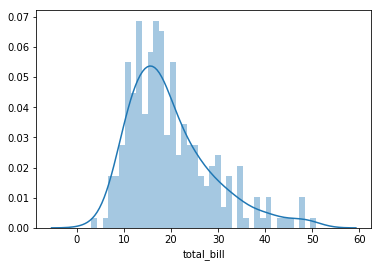

In [50]:
# 데이터 히스토그램 분포를 시각화
sns.distplot(tips['total_bill'], bins=40)

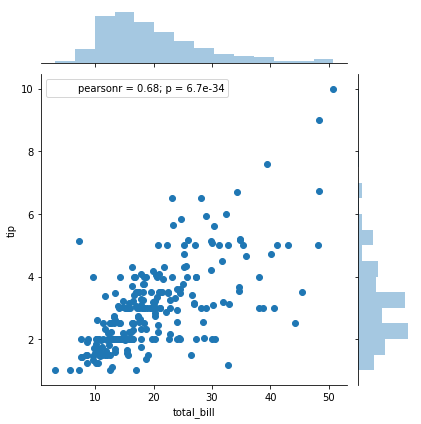

In [51]:
# 산점도 주번에 데이터 분포를 x축/ y축 나눠서 시각화
sns.jointplot(x = 'total_bill', y = 'tip', data=tips)

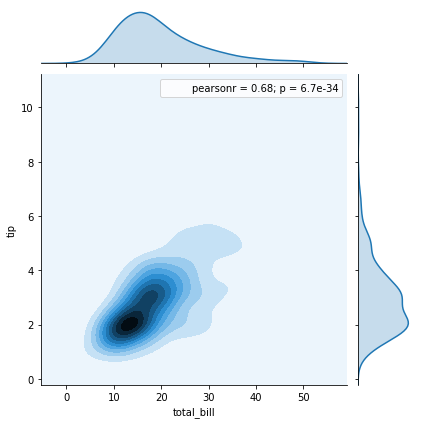

In [52]:
# 산점도 주번에 데이터 분포를 x축/ y축 나눠서 시각화
sns.jointplot(x = 'total_bill', y = 'tip', data=tips, kind="kde")

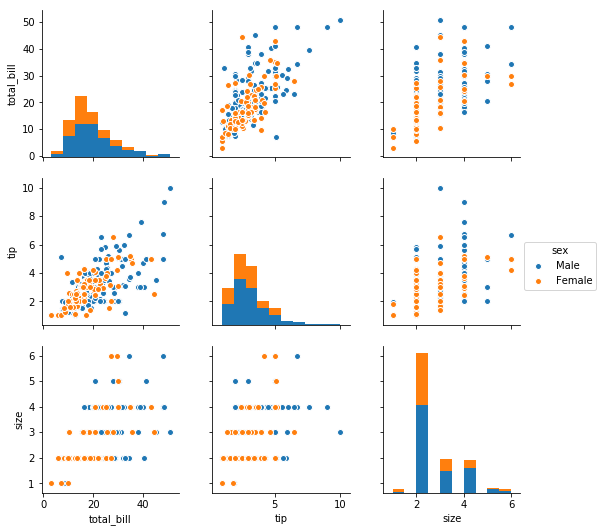

In [53]:
# 숫자로 입력된 데이터들의 상관분포
# hue = '컬럼' 해당 컬럼의 데이터별로 구분하여 색을 다르게 적용한다
sns.pairplot(tips, hue='sex')

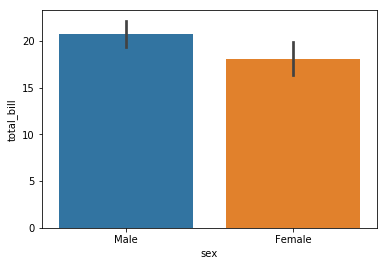

In [54]:
# 흡현자 /비흡연자를 남녀 구분하여 시각화
sns.barplot(x='sex', y='total_bill', data=tips)

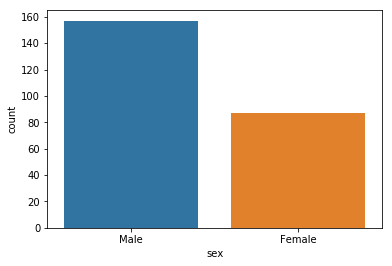

In [55]:
# 분류기준에 따라서 갯수를 구분
sns.countplot(x = 'sex', data=tips)

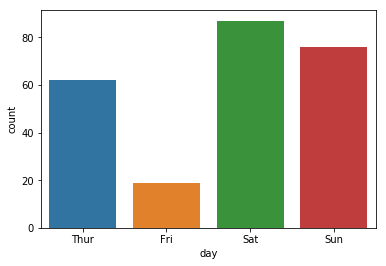

In [56]:
sns.countplot(x = 'day', data=tips)

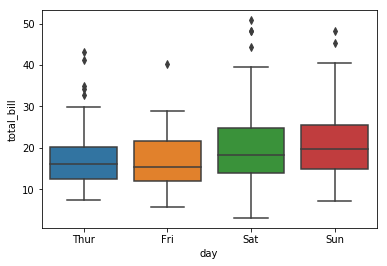

In [57]:
# 요일별 4분위 분포를 시각화
sns.boxplot(x='day', y='total_bill', data=tips)

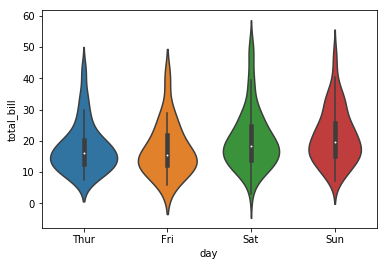

In [58]:
sns.violinplot(x="day", y="total_bill", data=tips)

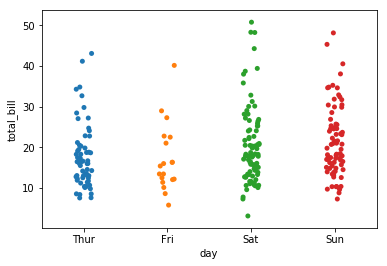

In [59]:
sns.stripplot(x="day", y="total_bill", data=tips, jitter=True)

<br>
###  **02 통계적 분석 2 - Heat Map**
sns.heatmap()

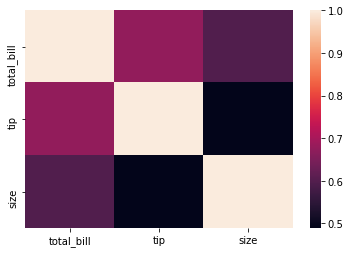

In [60]:
# DataFrame의 상관관계를 게산한다
tc = tips.corr()
sns.heatmap(tc)

year,1949,1950,1951,1952,1953,1954,1955,1956,1957,1958,1959,1960
month,,,,,,,,,,,,
January,112,115,145,171,196,204,242,284,315,340,360,417
February,118,126,150,180,196,188,233,277,301,318,342,391
March,132,141,178,193,236,235,267,317,356,362,406,419
April,129,135,163,181,235,227,269,313,348,348,396,461
May,121,125,172,183,229,234,270,318,355,363,420,472


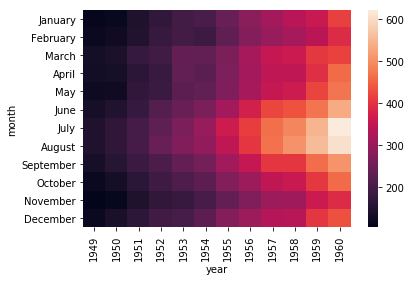

In [61]:
flights = sns.load_dataset('flights')
fp = flights.pivot_table(index = 'month', columns='year', values='passengers')
sns.heatmap(fp)
fp.head()  # 월별 항공사 이용자수

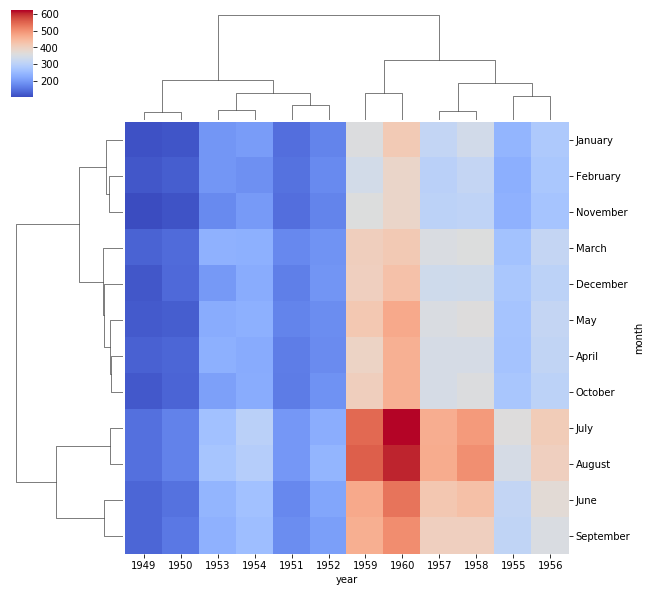

In [63]:
# 데이터간의 Decision Tree 분석결과를 시각화
sns.clustermap(fp, cmap='coolwarm')

<br>
###  **03 통계적 분석 3 - 선형회귀식 도출하기**
sns.load_dataset('tips')

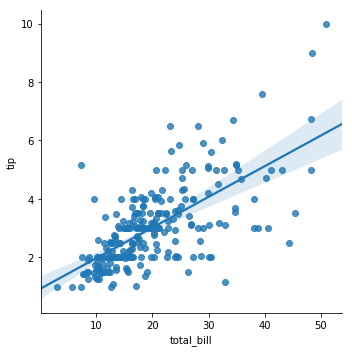

In [64]:
# 선형회귀식을 시각화
sns.lmplot(x = 'total_bill', y='tip', data=tips)

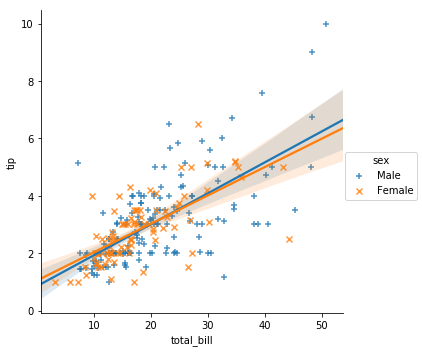

In [65]:
# 선형회귀식을 시각화
sns.lmplot(x = 'total_bill', y='tip', data=tips, hue='sex', markers=['+', 'x'])

<br>
###  **04 종합적인 시각화**
2개 이상의 시각화를 겹치게 출력하여 다양한 효과를 부여가능

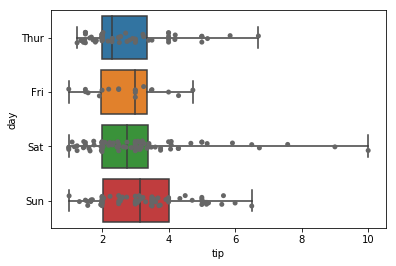

In [66]:
# 
sns.boxplot(x="tip", y="day", data=tips, whis=np.inf)
sns.stripplot(x="tip", y="day", data=tips, jitter=True, color="0.4")